In [29]:
import pandas as pd
import numpy as np
from Anomalie_detection_event_extraction import db_query, extract_production_run_frame, extract_phase_stamps, phase_frame_merger, extract_event_descriptions_for_timewindows
from datetime import datetime, timedelta
import pytz
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.dates import DateFormatter
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import StandardScaler
from IPython.display import display, HTML
import re
from collections import Counter
import mlflow


In [2]:
def create_anomaly_phaseplots(frame, group_column = '_production_run_index'):
    Anomalous_frame = frame[frame["_anomaly"]==-1]
    grouped = frame.groupby(group_column)
    num_plots = len(grouped)
    num_cols = 3
    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
    
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
    date_format = DateFormatter('%H:%M')

    for ax, (name, group) in zip(axes, grouped):  
        ax.plot(group['_value'].sort_index())
        
        anomalous_group = Anomalous_frame[Anomalous_frame[group_column] == name]
        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
            
        ax.set_title(f'Line Plot for _production_run_index: {name}')
        ax.set_xlabel('Timestamp')
        ax.set_ylabel('_value')
        ax.xaxis.set_major_formatter(date_format)
        ax.grid(True)

    # Hide empty subplots if any
    for i in range(num_plots, num_rows * num_cols):
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()
    


def create_basic_phaseplots(frame, group_column='_production_run_index', timestamp_dict=None):
    grouped = frame.groupby(group_column)
    num_plots = len(grouped)
    num_cols = 3
    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 4*num_rows))
    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
    date_format = DateFormatter('%H:%M')
    if timestamp_dict:
        colors = plt.cm.jet(np.linspace(0, 1, len(timestamp_dict)))

    for ax, (name, group) in zip(axes, grouped):
        if "_value" in frame.columns:
            ax.plot(group['_time'], group['_value'].sort_index())
        if "_moving_mean" in frame.columns:
            ax.plot(group['_time'], group['_moving_mean'].sort_index())
        if "_moving_std" in frame.columns:
            ax.plot(group['_time'], group['_moving_std'].sort_index())
        if "_print_prog" in frame.columns:
            ax.plot(group[group['_print_prog'] == 1]['_time'],
                group[group['_print_prog'] == 1]['_value'],
                'ro')
            ax.plot(group[group['_print_prog'] == 0]['_time'],
                group[group['_print_prog'] == 0]['_value'],
                'go')
        ax.set_title(f'Line Plot for _production_run_index: {name}')
        ax.set_xlabel('Timestamp')
        ax.set_ylabel('_value')
        ax.xaxis.set_major_formatter(date_format)
        ax.grid(True)
        
        if timestamp_dict:
            lines = []  # Store lines for each key
            key_labels = []  # Store labels for each key
            group_time_np = group['_time'].values.astype('datetime64[ns]')
            for i, (key, timestamps) in enumerate(timestamp_dict.items()):
                timestamp_np = np.array(timestamps).astype('datetime64[ns]')
                common_timestamps = np.intersect1d(group_time_np, timestamp_np)
                
                if len(common_timestamps) > 0:
                    common_mask = np.isin(group_time_np, common_timestamps)
                    
                    for ts in common_timestamps:
                        ax.axvline(x=ts, color=colors[i])
                        line, = ax.plot([], [], 'o', color=colors[i])  # Empty plot for setting legend
                        lines.append(line)
                        key_labels.append(f"{key}")

            # Add legend for the current key's timestamps
                ax.legend(lines, key_labels)

    for i in range(num_plots, num_rows * num_cols):
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()


def round_for_display(timestamps_list):
    all_timestamps=[]
    for timestamp in timestamps_list:
        rounded_timestamp = timestamp.round('1s')
        adjusted_timestamp = rounded_timestamp + pd.Timedelta(seconds=1)
    
    # Append both timestamps to the list
        all_timestamps.append(rounded_timestamp)
        all_timestamps.append(adjusted_timestamp)
    
    return all_timestamps

def correct_first_diff(df, col='_value'):
    previous_index = None

    for index, row in df.iterrows():
        current_index = row['_production_run_index']
    
        if current_index != previous_index:
            df.at[index,col] = 0  # Set _value to 0 for the first row with a new _production_run_index
            previous_index = current_index
    return df 

'''
def find_extreme_sequence_timestamps(df, col):
    timestamps = []

    for index, group in df.groupby('_production_run_index'):
        sorted_values = group[col].sort_values(ascending=False)        
        # Get the first value from the five biggest and five lowest values
        
        biggest_values = sorted_values.head(5)
        lowest_values = sorted_values.tail(5)

        # Check for sequences
        for i in range(len(group) - 1):
            if (group.iloc[i][col] in biggest_values.values) and (group.iloc[i+1][col] in lowest_values.values):
                timestamp = group.iloc[i]['_time']
                timestamps.append(timestamp)
                break  # Break after finding the first sequence

    return timestamps

def end_of_extreme_sequence_timestamps(df,col):    
    timestamps = []
    

    for index, group in df.groupby('_production_run_index'):
        # Get the first value from the five biggest and five lowest values
        
        start_stamp = chaos_stamps[index-1]
        counter = 0
        # Check for sequences
        for i in range(len(group) - 1):
            if group.iloc[i]["_time"]>start_stamp:
                counter += 1
            if group.iloc[i][col] < 0 and group.iloc[i]["_moving_std"] < group["_moving_std"].mean()-0.2 * group["_moving_std"].std() and counter > 15:
                timestamp = group.iloc[i]['_time']
                timestamps.append(timestamp)
                break  # Break after finding the value
            
    return timestamps

def acceleration_start_timestamps(df,col):    
    timestamps = []
    

    for index, group in df.groupby('_production_run_index'):
        # Get the first value from the five biggest and five lowest values
        
        start_stamp = end_stamps[index-1]
        counter = 0
        end = len(group)-1
        # Check for sequences
        for i in range(len(group) - 1):
            if group.iloc[i]["_time"]>start_stamp:
                counter += 1
            if (group.iloc[i][col] - group.iloc[i-1][col]) > 0.1 * group[col].std() and counter > 15 and end - i < 50:
                timestamp = group.iloc[i]['_time']
                timestamps.append(timestamp)
                break  # Break after finding the value
                
    return timestamps
'''
def calculate_moving_metric(df, fun, window_size=10):
    # Convert '_time' column to datetime if not already in that format
    # Group by '_production_run_index' and calculate rolling mean for each group
    if fun == "mean":
        moving_averages = df.groupby('_production_run_index')['_value'].rolling(window=window_size, min_periods=1).mean()
    if fun == "std":
        moving_averages = df.groupby('_production_run_index')['_value'].rolling(window=window_size, min_periods=1).std() 
    df[f"_moving_{fun}"] = moving_averages.values
    return df

def format_time_for_sql(timestamp):
    if isinstance(timestamp, pd.Timestamp):
        # Convert the pandas timestamp to the desired timezone
        if timestamp.tzinfo is None:
            transformed_stamp = timestamp.tz_localize('UTC').tz_convert(desired_timezone)
        else:     
            transformed_stamp = timestamp.tz_convert(desired_timezone)
    # Check if the timestamp is a numpy datetime64
    elif isinstance(timestamp, np.datetime64):
        # Convert the numpy timestamp to a pandas Timestamp and then to the desired timezone
        transformed_stamp = pd.Timestamp(timestamp).tz_localize('UTC').tz_convert(desired_timezone)
# Format the datetime object into the required timestamp format with 3 decimal places for milliseconds
    formatted_stamp= transformed_stamp.strftime('%Y-%m-%d %H:%M:%S.%f')[:-3] + transformed_stamp.strftime('%z')
    return formatted_stamp

def identify_active_phases(df, Druck_an, Druck_ab):
    df=df.reset_index()
    print_prog = []
    _x_time = []
    printing_marker = True
    eins_time_index = 1
    null_time_index = 1
    
    for index, row in df.iterrows():
        if index !=0:
            if row["_production_run_index"] != df.at[index-1, "_production_run_index"]:
                printing_marker = True
                eins_time_index = 1
            if row["_time"] in Druck_ab:
                printing_marker = False
                null_time_index = 1
            if row["_time"] in Druck_an:
                printing_marker = True
                eins_time_index = 1
                
        if printing_marker:
            print_prog.append(1)
            _x_time.append(eins_time_index)
            eins_time_index += 1
        else:
            print_prog.append(0)
            _x_time.append(null_time_index)
            null_time_index += 1
    df["_print_prog"] = print_prog
    df["_x_time"] = _x_time
    return df.drop(["index"], axis=1)

def check_for_errors(string_list):
    
    error_regex_list = [re.compile(r'fehl(?!erfrei)', re.IGNORECASE), 
                        re.compile(r'not', re.IGNORECASE), 
                        re.compile(r'warn', re.IGNORECASE),
                        re.compile(r'stop', re.IGNORECASE),
                        re.compile(r'inaktiv', re.IGNORECASE),
                        re.compile(r'defekt', re.IGNORECASE),
                        re.compile(r'aus', re.IGNORECASE),
                        re.compile(r'nicht', re.IGNORECASE),
                        re.compile(r'halt', re.IGNORECASE),
                        re.compile(r'ueber', re.IGNORECASE),
                        re.compile(r'alarm', re.IGNORECASE),
                        re.compile(r'stör', re.IGNORECASE),
                        re.compile(r'stoer', re.IGNORECASE),
                        re.compile(r'abweich', re.IGNORECASE),
                        re.compile(r'verzögert', re.IGNORECASE),
                        re.compile(r'verzoegert', re.IGNORECASE),
                        re.compile(r'sicher-halt', re.IGNORECASE),
                        re.compile(r'defekt', re.IGNORECASE),
                        re.compile(r'gesperrt', re.IGNORECASE),
                        re.compile(r'außerhalb gültigem Bereich', re.IGNORECASE),
                        ]

# List to store strings matching the regular expressions
    matching_strings = []

# Iterate through the list of strings
    for s in string_list:
        # Check each regular expression in the list
        for error_regex in error_regex_list:
            if error_regex.search(s):
                # If a match is found, add the string to the matching_strings list
                matching_strings.append(s)
                break
            
    return matching_strings


def shift_timestamps_earlier(timestamps):
    shifted_timestamps = []
    for ts in timestamps:
        shifted_ts = ts - timedelta(seconds=5)
        shifted_timestamps.append(shifted_ts)
    return shifted_timestamps

def shift_timestamps_later(timestamps):
    shifted_timestamps = []
    for ts in timestamps:
        shifted_ts = ts + timedelta(seconds=15)
        shifted_timestamps.append(shifted_ts)
    return shifted_timestamps

def group_timestamps(timestamps):
    time_win_start = []
    time_win_end = []
    current_group = [timestamps[0]]
    groupings = 0 
    for i in range(1, len(timestamps)):
        diff = (timestamps[i] - timestamps[i-1])
    
        if diff <= np.timedelta64(20, 's'):
            current_group.append(timestamps[i])
        else:
             #Check if current_group contains more than one timestamp
            if len(current_group) > 1:
            
                time_win_end.append(max(current_group))
                time_win_start.append(min(current_group))
                groupings +=1 
            else:
                # If no, just copy the single timestamp
                time_win_end.append(current_group[0])
                time_win_start.append(current_group[0])
                pass
            # Start a new group with the current timestamp
            current_group = [timestamps[i]]

    # Add the last group if it contains more than one timestamp
    if len(current_group) > 1:
        time_win_end.append(max(current_group))
        time_win_start.append(min(current_group))
    else:
        time_win_end.append(current_group[0])
        time_win_start.append(current_group[0])
        pass 
    
    print(f"{groupings} groups could be identified")
    
    return time_win_start, time_win_end

def plot_string_occurences(string_list):
    string_counter = Counter(string_list)

    # Extract distinct strings and their counts
    distinct_strings = list(string_counter.keys())
    counts = list(string_counter.values())

    # Plot the bar chart
    fig, ax = plt.subplots(figsize=(15,20))
    ax.barh(distinct_strings, counts, color='skyblue')

    # Set labels and title
    ax.set_xlabel('Occurrences')
    ax.set_ylabel('Strings')
    ax.set_title('Occurrences of Distinct Strings')
    plt.show()


In [3]:
sensor_data_frame_train = pd.read_csv("C:\\Users\\JoshuaBraun\\Downloads\\query (25).csv", delimiter=",",skiprows=3, nrows=200000)
sensor_data_frame_test =  pd.read_csv("C:\\Users\\JoshuaBraun\\Downloads\\query (25).csv", delimiter=",",skiprows=200003, nrows=100000, header=None)


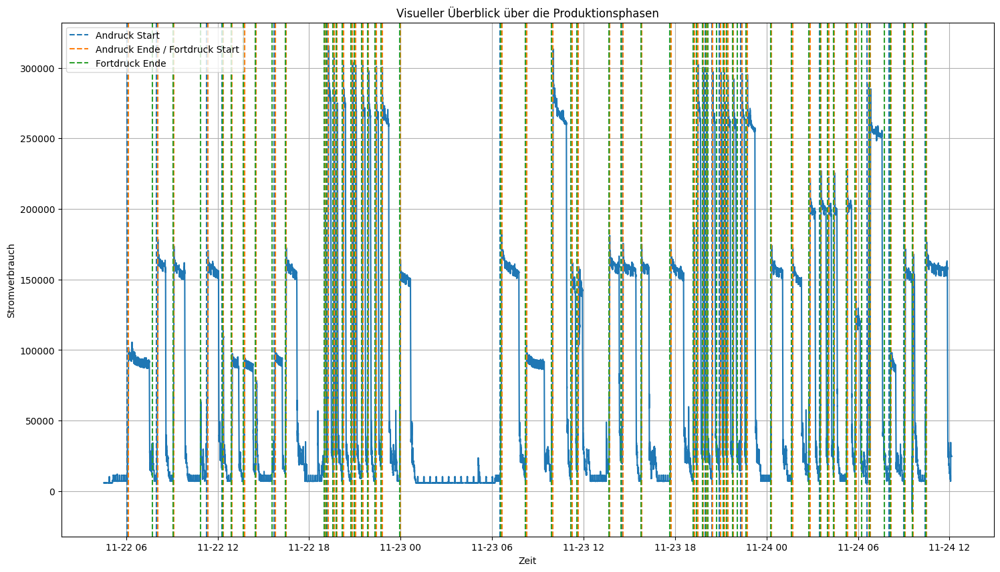

In [4]:
sensor_data_frame_test = sensor_data_frame_test.iloc[:,[5,6]]
sensor_data_frame_test.columns = ["_time","_value"]

sensor_data_frame_test["_time"] = pd.to_datetime(sensor_data_frame_test["_time"], format='mixed')
sensor_data_frame_test = sensor_data_frame_test.sort_values(by=["_time"]).reset_index().drop(["index"], axis=1)


#extracting timestamps at the beginning and the end of our timeframe
index_stamps = sensor_data_frame_test["_time"]
start_of_timeframe = index_stamps[0]
end_of_timeframe = index_stamps[len(index_stamps)-1]

desired_timezone = pytz.timezone('Etc/GMT-1')


formatted_start = format_time_for_sql(start_of_timeframe)
formatted_end = format_time_for_sql(end_of_timeframe)

#Extract Events and Timestamps
event_frame = extract_production_run_frame(formatted_start, formatted_end)
Andruck_start,Andruck_zu_Fortdruck,Fortdruck_ende, Druck_an_test, Druck_ab_test = extract_phase_stamps(event_frame)

plt.figure(figsize=(18, 10))

plt.plot(sensor_data_frame_test["_time"].sort_values(), sensor_data_frame_test["_value"])
# Create a dictionary to store the colors and lists

timestamp_lists = {
    'Andruck Start': Andruck_start,
    'Andruck Ende / Fortdruck Start': Andruck_zu_Fortdruck,
    'Fortdruck Ende': Fortdruck_ende,
    
}


# Plot vertical lines for each list with different colors
for label, timestamp_list in timestamp_lists.items():
    color = plt.cm.tab10(list(timestamp_lists.keys()).index(label))
    for timestamp in timestamp_list:
        plt.axvline(x=timestamp, color=color, linestyle='--', label=label if timestamp == timestamp_list[0] else '_nolegend_')

# Set labels and legend
plt.xlabel('Zeit')
plt.ylabel('Stromverbrauch')
plt.title('Visueller Überblick über die Produktionsphasen')
plt.legend()
plt.grid(True)
plt.show()


count_of_finished_phases = min([len(Andruck_start),len(Andruck_zu_Fortdruck),len(Fortdruck_ende)])
Andruck_start = Andruck_start[0:count_of_finished_phases]
Andruck_zu_Fortdruck = Andruck_zu_Fortdruck[0:count_of_finished_phases]
Fortdruck_ende = Fortdruck_ende[0:count_of_finished_phases] 
#create subsets of dataframes
Andruck_frame_test, Fortdruck_frame_test = phase_frame_merger(Andruck_start, Andruck_zu_Fortdruck, Fortdruck_ende, sensor_data_frame_test)

raw_Andruck_frame_test = Andruck_frame_test.copy()
raw_Fortdruck_frame_test = Fortdruck_frame_test.copy()


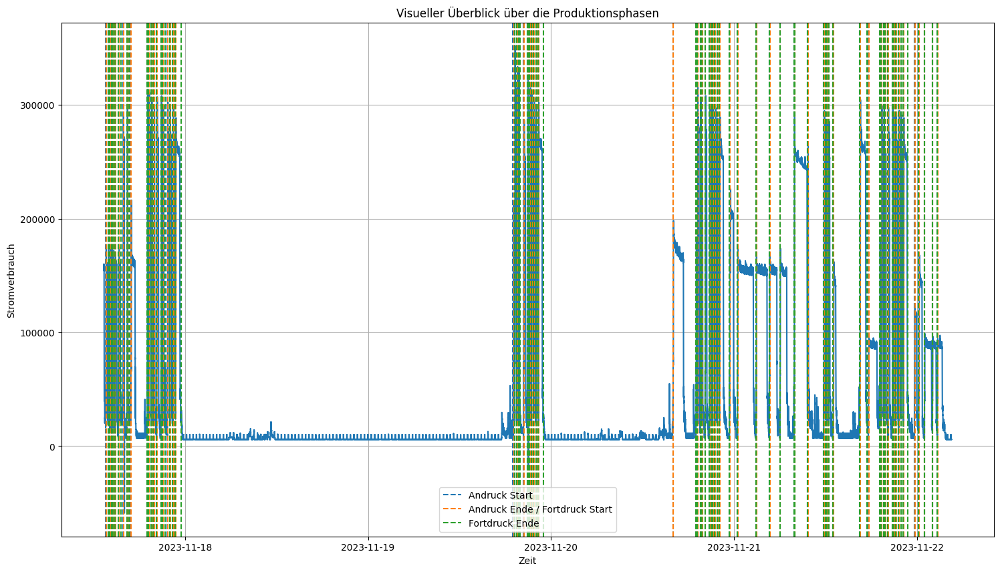

In [5]:
sensor_data_frame_train = sensor_data_frame_train.iloc[:,[5,6]]

sensor_data_frame_train["_time"] = pd.to_datetime(sensor_data_frame_train["_time"], format='mixed')
sensor_data_frame_train = sensor_data_frame_train.sort_values(by=["_time"]).reset_index().drop(["index"], axis=1)


#extracting timestamps at the beginning and the end of our timeframe
index_stamps = sensor_data_frame_train["_time"]
start_of_timeframe = index_stamps[0]
end_of_timeframe = index_stamps[len(index_stamps)-1]

desired_timezone = pytz.timezone('Etc/GMT-1')


formatted_start = format_time_for_sql(start_of_timeframe)
formatted_end = format_time_for_sql(end_of_timeframe)
event_frame = extract_production_run_frame(formatted_start, formatted_end)
Andruck_start,Andruck_zu_Fortdruck,Fortdruck_ende, Druck_an_train, Druck_ab_train = extract_phase_stamps(event_frame)

plt.figure(figsize=(18, 10))

plt.plot(sensor_data_frame_train["_time"].sort_values(), sensor_data_frame_train["_value"])
# Create a dictionary to store the colors and lists

timestamp_lists = {
    'Andruck Start': Andruck_start,
    'Andruck Ende / Fortdruck Start': Andruck_zu_Fortdruck,
    'Fortdruck Ende': Fortdruck_ende,
    
}


# Plot vertical lines for each list with different colors
for label, timestamp_list in timestamp_lists.items():
    color = plt.cm.tab10(list(timestamp_lists.keys()).index(label))
    for timestamp in timestamp_list:
        plt.axvline(x=timestamp, color=color, linestyle='--', label=label if timestamp == timestamp_list[0] else '_nolegend_')

# Set labels and legend
plt.xlabel('Zeit')
plt.ylabel('Stromverbrauch')
plt.title('Visueller Überblick über die Produktionsphasen')
plt.legend()
plt.grid(True)
plt.show()

count_of_finished_phases = min([len(Andruck_start),len(Andruck_zu_Fortdruck),len(Fortdruck_ende)])
Andruck_start = Andruck_start[0:count_of_finished_phases]
Andruck_zu_Fortdruck = Andruck_zu_Fortdruck[0:count_of_finished_phases]
Fortdruck_ende = Fortdruck_ende[0:count_of_finished_phases] 
#create subsets of dataframes
Andruck_frame_train, Fortdruck_frame_train = phase_frame_merger(Andruck_start, Andruck_zu_Fortdruck, Fortdruck_ende, sensor_data_frame_train)

raw_Andruck_frame_train = Andruck_frame_train.copy()
raw_Fortdruck_frame_train = Fortdruck_frame_train.copy()

In [6]:
#difference timeseries twice to remove trends
diff_Druck_train = pd.concat([Andruck_frame_train.drop(["_value"], axis=1), Andruck_frame_train["_value"].diff()], axis=1)
diff_Druck_train= correct_first_diff(diff_Druck_train)
diff_Druck_train = pd.concat([diff_Druck_train.drop(["_value"], axis=1), diff_Druck_train["_value"].diff()], axis=1)
diff_Druck_train= correct_first_diff(diff_Druck_train)

diff_Fort_train = pd.concat([Fortdruck_frame_train.drop(["_value"], axis=1), Fortdruck_frame_train["_value"].diff()], axis=1)
diff_Fort_train = correct_first_diff(diff_Fort_train)
diff_Fort_train = pd.concat([diff_Fort_train.drop(["_value"], axis=1), diff_Fort_train["_value"].diff()], axis=1)
diff_Fort_train = correct_first_diff(diff_Fort_train)


diff_Druck_test = pd.concat([Andruck_frame_test.drop(["_value"], axis=1), Andruck_frame_test["_value"].diff()], axis=1)
diff_Druck_test= correct_first_diff(diff_Druck_test)
diff_Druck_test = pd.concat([diff_Druck_test.drop(["_value"], axis=1), diff_Druck_test["_value"].diff()], axis=1)
diff_Druck_test= correct_first_diff(diff_Druck_test)

diff_Fort_test = pd.concat([Fortdruck_frame_train.drop(["_value"], axis=1), Fortdruck_frame_train["_value"].diff()], axis=1)
diff_Fort_test = correct_first_diff(diff_Fort_test)
diff_Fort_test = pd.concat([diff_Fort_test.drop(["_value"], axis=1), diff_Fort_test["_value"].diff()], axis=1)
diff_Fort_test = correct_first_diff(diff_Fort_test)


#splitting Fortdruck into active and inactive phases
Druck_ab_train = round_for_display(Druck_ab_train)
Druck_an_train = round_for_display(Druck_an_train)

Druck_ab_test = round_for_display(Druck_ab_test)
Druck_an_test = round_for_display(Druck_an_test)

diff_Fort_identified_train = identify_active_phases(diff_Fort_train, Druck_an_train, Druck_ab_train)
diff_Fort_identified_test = identify_active_phases(diff_Fort_test, Druck_an_test, Druck_ab_test)


Fortdruck_frame_active_test = diff_Fort_identified_test.loc[diff_Fort_identified_test["_print_prog"]==1]
Fortdruck_frame_inactive_test =  diff_Fort_identified_test.loc[diff_Fort_identified_test["_print_prog"]==0]

Fortdruck_frame_active_train = diff_Fort_identified_train.loc[diff_Fort_identified_train["_print_prog"]==1]
Fortdruck_frame_inactive_train =  diff_Fort_identified_train.loc[diff_Fort_identified_train["_print_prog"]==0]

,_production_run_index,_x_time,_value,_print_prog
count,73515.000000,73515.000000,73515.000000,73515.0
mean,43.552513,1253.780575,0.225832,1.0
std,19.096669,1298.095565,3094.369719,0.0
min,1.000000,1.000000,-322654.800781,1.0
25%,34.000000,257.000000,-427.747559,1.0
50%,48.000000,750.000000,2.847656,1.0
75%,58.000000,1925.000000,499.804688,1.0
max,75.000000,6126.000000,331324.558594,1.0


In [7]:
time_scaler_Andruck = StandardScaler()
value_scaler_Andruck = StandardScaler()
time_scaler_Fortdruck_inactive = StandardScaler()
value_scaler_Fortdruck_inactive = StandardScaler()
time_scaler_Fortdruck_active = StandardScaler()
value_scaler_Fortdruck_active = StandardScaler()

diff_Druck_train["_x_time"] = time_scaler_Andruck.fit_transform(diff_Druck_train["_x_time"].values.reshape(-1,1))
diff_Druck_train["_value"] = value_scaler_Andruck.fit_transform(diff_Druck_train["_value"].values.reshape(-1,1))
diff_Druck_test["_x_time"] = time_scaler_Andruck.transform(diff_Druck_test["_x_time"].values.reshape(-1,1))
diff_Druck_test["_value"] = value_scaler_Andruck.transform(diff_Druck_test["_value"].values.reshape(-1,1))


In [14]:

Fortdruck_frame_inactive_train["_x_time"] = time_scaler_Fortdruck_inactive.fit_transform(Fortdruck_frame_inactive_train["_x_time"].values.reshape(-1,1))
Fortdruck_frame_inactive_train["_value"] = value_scaler_Fortdruck_inactive.fit_transform(Fortdruck_frame_inactive_train["_value"].values.reshape(-1,1))
try:
    Fortdruck_frame_inactive_test["_x_time"] = time_scaler_Fortdruck_inactive.transform(Fortdruck_frame_inactive_test["_x_time"].values.reshape(-1,1))
    Fortdruck_frame_inactive_test["_value"] = value_scaler_Fortdruck_inactive.transform(Fortdruck_frame_inactive_test["_value"].values.reshape(-1,1))
except ValueError:
    no_inactive_phase_indicator = True

Fortdruck_frame_active_train["_x_time"] = time_scaler_Fortdruck_active.fit_transform(Fortdruck_frame_active_train["_x_time"].values.reshape(-1,1))
Fortdruck_frame_active_train["_value"] = value_scaler_Fortdruck_active.fit_transform(Fortdruck_frame_active_train["_value"].values.reshape(-1,1))
Fortdruck_frame_active_test["_x_time"] = time_scaler_Fortdruck_active.transform(Fortdruck_frame_active_test["_x_time"].values.reshape(-1,1))
Fortdruck_frame_active_test["_value"] = value_scaler_Fortdruck_active.transform(Fortdruck_frame_active_test["_value"].values.reshape(-1,1))

LOF_an = LocalOutlierFactor(n_neighbors=int((np.sqrt(len(diff_Druck_train)))), contamination=0.01)
#raw_Andruck_frame_train ["_anomaly"] = LOF_an.fit_predict(diff_Druck.loc[:,["_x_time", "_value"]])
#diff_Druck_train["_anomaly"] = LOF_an.fit_predict(diff_Druck_train.loc[:,["_x_time", "_value"]])
diff_Druck_train_cleaned = diff_Druck_train.loc[diff_Druck_train["_anomaly"]!=-1]
NOV_an = LocalOutlierFactor(n_neighbors=int((np.sqrt(len(diff_Druck_train)))), novelty=True, contamination = 0.00001)
NOV_an.fit(diff_Druck_train_cleaned.loc[:,["_x_time", "_value"]])
raw_Andruck_frame_test["_anomaly"]=NOV_an.predict(diff_Druck_test.loc[:,["_x_time", "_value"]])
create_anomaly_phaseplots(raw_Andruck_frame_test)
#plt.scatter(diff_Druck["_x_time"], diff_Druck["_value"], label='observed data', alpha=0.1)
#plt.scatter(diff_Druck.loc[diff_Druck["_anomaly"]==-1]["_x_time"], diff_Druck.loc[diff_Druck["_anomaly"]==-1]["_value"], color="red")
#plt.scatter(frame_with_poly["_x_time"],LinReg.predict(X), label="fitted function" )
#plt.legend()


LOF_fort_inactive = LocalOutlierFactor(n_neighbors=int((np.sqrt(len(Fortdruck_frame_inactive)))), contamination=0.01)
Fortdruck_frame_inactive["_anomaly"]= LOF_fort_inactive.fit_predict(Fortdruck_frame_inactive.loc[:,["_x_time", "_value"]])
plt.scatter(Fortdruck_frame_inactive["_x_time"], Fortdruck_frame_inactive["_value"], label='observed data', alpha=0.1)
plt.scatter(Fortdruck_frame_inactive.loc[Fortdruck_frame_inactive["_anomaly"]==-1]["_x_time"], Fortdruck_frame_inactive.loc[Fortdruck_frame_inactive["_anomaly"]==-1]["_value"], color="red")
#plt.scatter(frame_with_poly["_x_time"],LinReg.predict(X), label="fitted function" )
plt.legend()


LOF_fort_active = LocalOutlierFactor(n_neighbors=int((np.sqrt(len(Fortdruck_frame_active)))), contamination=0.005)
Fortdruck_frame_active["_anomaly"]= LOF_fort_active.fit_predict(Fortdruck_frame_active.loc[:,["_x_time", "_value"]])
plt.scatter(Fortdruck_frame_active["_x_time"], Fortdruck_frame_active["_value"], label='observed data', alpha=0.1)
plt.scatter(Fortdruck_frame_active.loc[Fortdruck_frame_active["_anomaly"]==-1]["_x_time"], Fortdruck_frame_active.loc[Fortdruck_frame_active["_anomaly"]==-1]["_value"], color="red")
#plt.scatter(frame_with_poly["_x_time"],LinReg.predict(X), label="fitted function" )
plt.legend()



Fortdruck_frame_labeled = pd.concat([Fortdruck_frame_active, Fortdruck_frame_inactive], axis=0).sort_values(by=["_time"])
raw_Fortdruck_frame["_anomaly"]=Fortdruck_frame_labeled["_anomaly"].values
raw_Fortdruck_frame["_print_prog"]=Fortdruck_frame_labeled["_print_prog"].values
#create_anomaly_phaseplots(raw_Fortdruck_frame)



anomaly_stamps_andruck = diff_Druck.loc[(diff_Druck["_anomaly"]==-1) & (diff_Druck["_x_time"] > 0) ]["_time"].values
anomaly_stamps_fortdruck = raw_Fortdruck_frame.loc[(raw_Fortdruck_frame["_anomaly"]==-1) ]["_time"].values
anomaly_stamps_andruck = raw_Andruck_frame.loc[(raw_Andruck_frame["_anomaly"]==-1) ]["_time"].values


In [23]:
'''
time_win_start, time_win_end = group_timestamps(anomaly_stamps_fortdruck)

start= pd.to_datetime(time_win_start)
end = pd.to_datetime(time_win_end)

time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

#anomaly_event_frame_fortdruck = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
'''

'\ntime_win_start, time_win_end = group_timestamps(anomaly_stamps_fortdruck)\n\nstart= pd.to_datetime(time_win_start)\nend = pd.to_datetime(time_win_end)\n\ntime_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]\ntime_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]\n\n#anomaly_event_frame_fortdruck = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)\n'

In [24]:
'''
time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

start= pd.to_datetime(time_win_start)
end = pd.to_datetime(time_win_end)

time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)

'''

'\ntime_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)\n\nstart= pd.to_datetime(time_win_start)\nend = pd.to_datetime(time_win_end)\n\ntime_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]\ntime_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]\n\nanomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)\n\n'

In [25]:

#plot_string_occurences(anomaly_event_frame_andruck["eventtext"].values)

In [26]:

#plot_string_occurences(check_for_errors(anomaly_event_frame_fortdruck["eventtext"].values))

In [16]:
experiment_ID = mlflow.set_experiment("1-Diff 7-Day Anomaly Detection LOF Tuning")
mlflow.sklearn.autolog()

In [ ]:
def track_run_lof(df_an,df_in,df_ak,run_name, description):
    '''
   
    '''
    with mlflow.start_run(
            run_name=f"{run_name}_Andruck",
            description=description):
        
        name = f"{run_name}_LOF"
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {i*0.1} neighbors LOF for Andruck",nested=True):
                        
                    
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_an))*i*0.1), algorithm="brute", contamination=i*0.0015)
                    raw_Andruck_frame_train["_anomaly"] = lof_an.fit_predict(df_an.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = raw_Andruck_frame_train[raw_Andruck_frame_train["_anomaly"]==-1]
                    grouped = raw_Andruck_frame_train.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i*0.001}%_contamination_growing_nbrs_de.png")
                    
                    #second plot
                    anomaly_stamps_andruck = raw_Andruck_frame_train.loc[(raw_Andruck_frame_train["_anomaly"]==-1) ]["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)

                    # Extract distinct strings and their counts
                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts)) 

                    # Save the figure
                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_growing_nbrs_de.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                        
                        
                        
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {19-i*0.1} neighbors LOF for Andruck",nested=True):
                    
                
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_an))*(19-(i*0.1))), algorithm="brute", contamination=i*0.0015)
                    raw_Andruck_frame_train["_anomaly"] = lof_an.fit_predict(df_an.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = raw_Andruck_frame_train[raw_Andruck_frame_train["_anomaly"]==-1]
                    grouped = raw_Andruck_frame_train.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i}%_contamination_{i*0.01}_nbrs_de.png")
                    
                    #second plot
                    anomaly_stamps_andruck = raw_Andruck_frame_train.loc[(raw_Andruck_frame_train["_anomaly"]==-1) ]["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)
                
                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_shrinking_nbrs_de.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                    
     
    #### Fortdruck inaktive Phase
     
     
                
    with mlflow.start_run(
            run_name=f"{run_name}_Fortdruck_inaktiv",
            description=description):
        
        name = "LOF"
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {i*0.05} neighbors LOF for Fortdruck inaktiv",nested=True):
                        
                    
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_in))*i*0.05), algorithm="brute", contamination=i*0.0015)
                    plotting_frame = raw_Fortdruck_frame_train.loc[raw_Fortdruck_frame_train["_print_prog"]==0]
                    plotting_frame["_anomaly"] = lof_an.fit_predict(df_in.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = plotting_frame[plotting_frame["_anomaly"]==-1]
                    grouped = plotting_frame.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i*0.001}%_contamination_growing_nbrs_in.png")
                    
                    #second plot
                    anomaly_stamps_andruck = Anomalous_frame["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                
                    err_string = check_for_errors(anomaly_event_frame_andruck["eventtext"].values)
                    string_counter = Counter(err_string)

                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i*0.001}%_contamination_growing_nbrs_in.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                        
                        
                        
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {9.5-i*0.1} neighbors LOF for Fortdruck inaktiv",nested=True):
                    
                
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_in))*(9.5-(i*0.05))), algorithm="brute", contamination=i*0.0015)
                    plotting_frame = raw_Fortdruck_frame_train.loc[raw_Fortdruck_frame_train["_print_prog"]==0]
                    plotting_frame["_anomaly"] = lof_an.fit_predict(df_in.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = plotting_frame[plotting_frame["_anomaly"]==-1]
                    grouped = plotting_frame.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i}%_contamination_{i*0.01}_nbrs_in.png")
                    
                    #second plot
                    anomaly_stamps_andruck = Anomalous_frame["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)

                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_shrinking_nbrs_in.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
     
     
     ####Fortdruck aktive Phase
     
     
                        
    with mlflow.start_run(
            run_name=f"{run_name}_Fortdruck_aktiv",
            description=description):
        
        name = "LOF"
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {i*0.05} neighbors LOF for Fortdruck aktiv",nested=True):
                        
                    
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_ak))*i*0.05), algorithm="brute", contamination=i*0.0015)
                    plotting_frame = raw_Fortdruck_frame_train.loc[raw_Fortdruck_frame_train["_print_prog"]==1]
                    plotting_frame["_anomaly"] = lof_an.fit_predict(df_ak.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = plotting_frame[plotting_frame["_anomaly"]==-1]
                    grouped = plotting_frame.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i*0.001}%_contamination_growing_nbrs_ak.png")
                    
                    #second plot
                    anomaly_stamps_andruck = Anomalous_frame["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)

                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i*0.001}%_contamination_growing_nbrs_ak.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                        
                        
                        
        for i in range(5,110,10):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {9.5-i*0.05} neighbors LOF for Fortdruck aktiv",nested=True):
                    
                
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_ak))*(9.5-(i*0.05))), algorithm="brute", contamination=i*0.0015)
                    plotting_frame = raw_Fortdruck_frame_train.loc[raw_Fortdruck_frame_train["_print_prog"]==1]
                    plotting_frame["_anomaly"] = lof_an.fit_predict(df_ak.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = plotting_frame[plotting_frame["_anomaly"]==-1]
                    grouped = plotting_frame.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i}%_contamination_{i*0.01}_nbrs_ak.png")
                    
                    #second plot
                    anomaly_stamps_andruck = Anomalous_frame["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)

                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_shrinking_nbrs_ak.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
    return

#track_run_lof(diff_Druck_train,Fortdruck_frame_inactive_train,Fortdruck_frame_active_train,run_name="7-Day-Timewindow",description=f"Datasets starts on {formatted_start} and ends on {formatted_end}. Differentiation was only perfromed once")

In [26]:
experiment_ID = mlflow.set_experiment("2-Diff 7-Day Anomaly Detection NOV Tuning")

2023/11/29 13:29:54 INFO mlflow.tracking.fluent: Experiment with name '2-Diff 7-Day Anomaly Detection NOV Tuning' does not exist. Creating a new experiment.


2023/11/29 15:49:10 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.
2023/11/29 15:49:10 WARNING mlflow.sklearn: Failed to infer model signature: the trained model does not have a `predict` or `transform` function, which is required in order to infer the signature
2023/11/29 15:49:10 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!
2023/11/29 15:49:41 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.


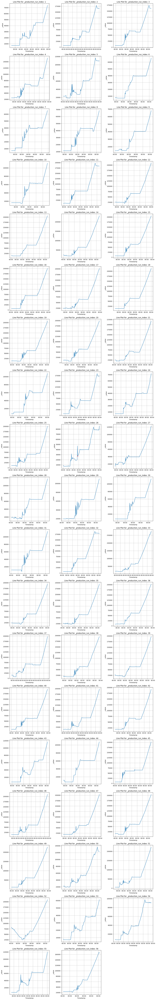

0 groups could be identified


2023/11/29 15:52:17 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.


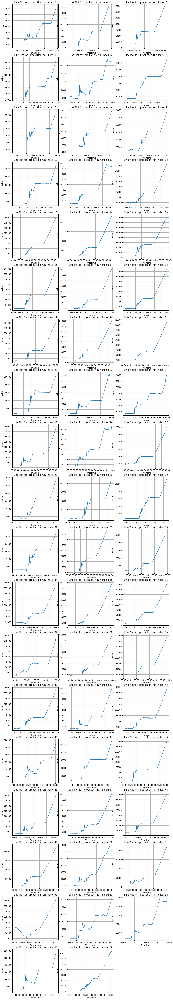

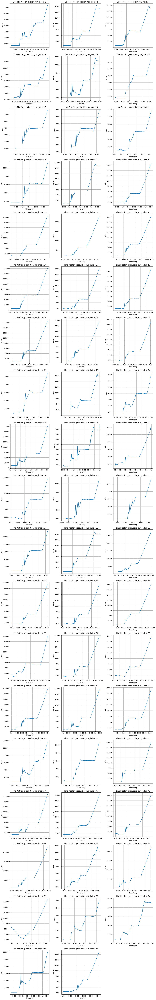

0 groups could be identified


2023/11/29 15:56:08 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.


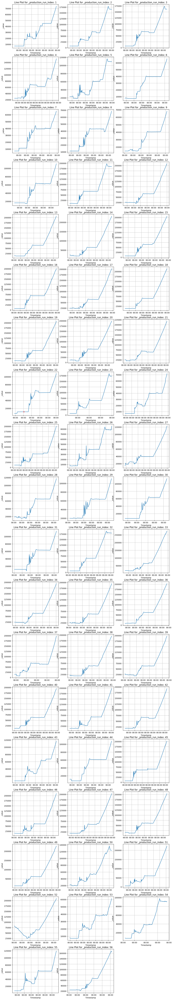

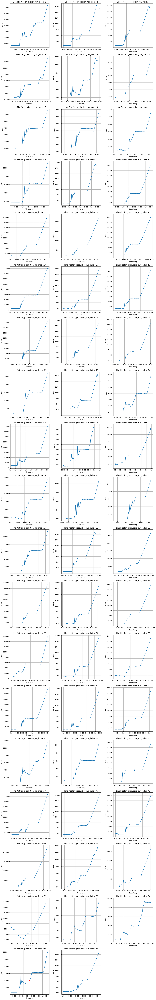

0 groups could be identified


2023/11/29 15:59:53 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.


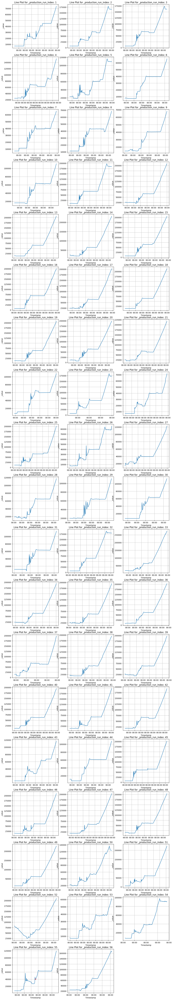

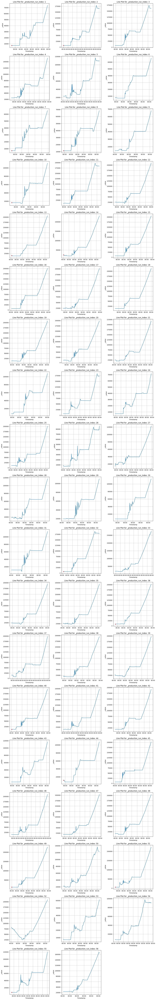

0 groups could be identified


2023/11/29 16:03:04 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.


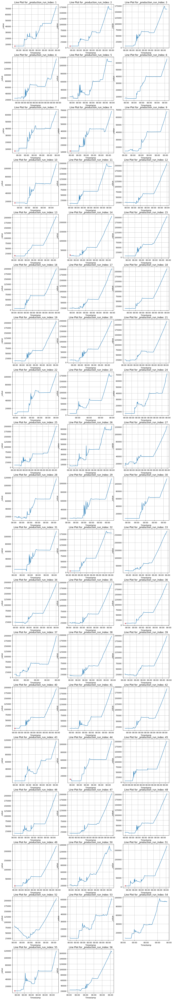

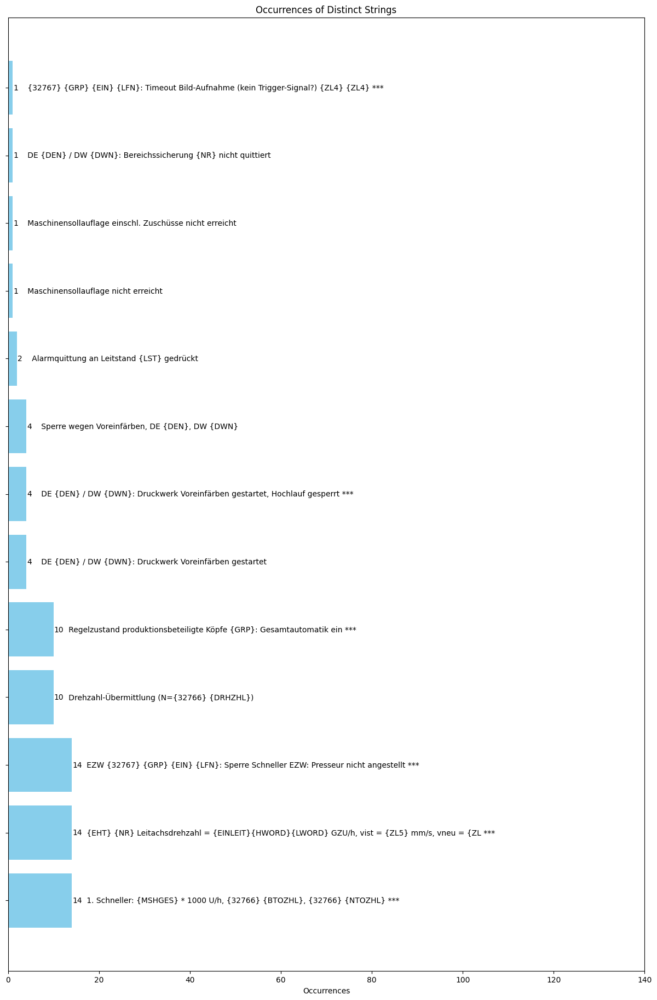

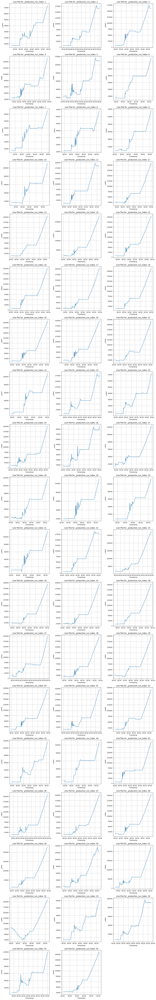

0 groups could be identified


2023/11/29 16:08:00 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.


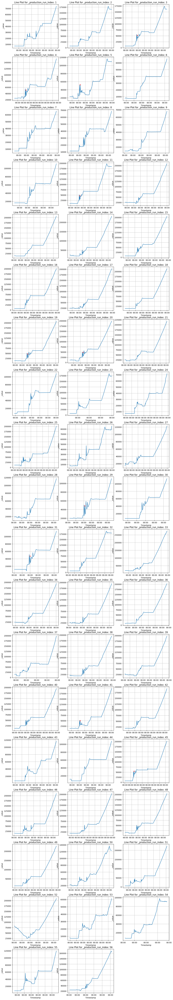

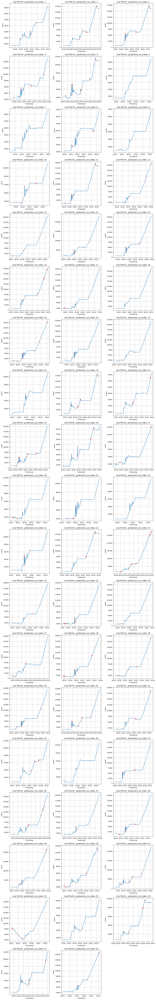

68 groups could be identified


2023/11/29 16:11:35 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.
2023/11/29 16:11:36 WARNING mlflow.sklearn: Failed to infer model signature: the trained model does not have a `predict` or `transform` function, which is required in order to infer the signature
2023/11/29 16:11:36 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!
2023/11/29 16:12:06 WARNING mlflow.sklearn: Training metrics will not be recorded because training labels were not specified. To automatically record training metrics, provide training labels as inputs to the model training function.


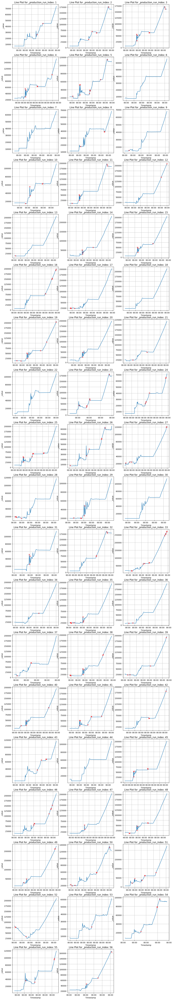

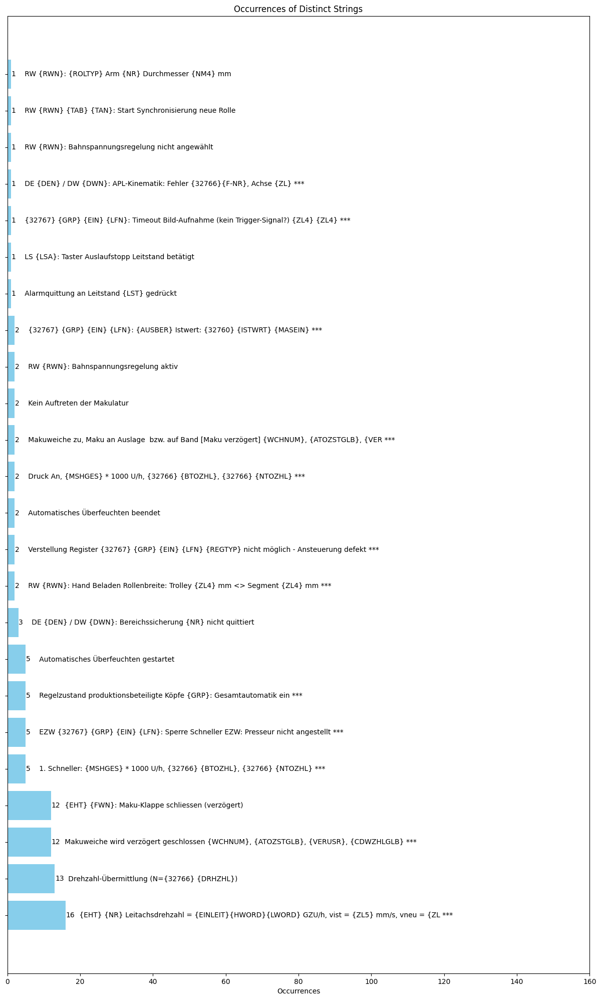

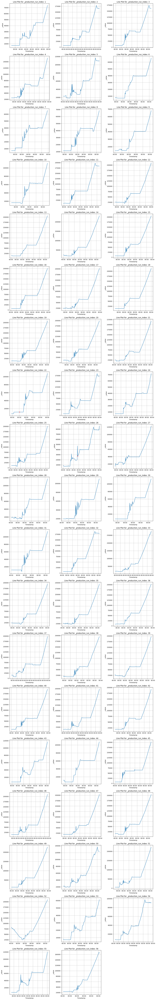

KeyboardInterrupt: 

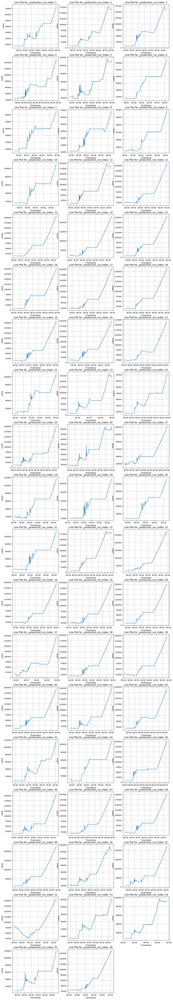

In [36]:
def track_run_nov(df_an_train,df_in_train,df_ak_train,df_an_test,df_in_test,df_ak_test,run_name, description):
    '''
   
    '''
    with mlflow.start_run(
            run_name=f"{run_name}_Andruck",
            description=description):
        
        name = f"{run_name}_NOV"
        for i in range(5,200,20):
            neighbrs = int(np.sqrt(len(df_an_train))*i*0.1)
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {neighbrs} neighbors LOF for Andruck",nested=True):
                
                    prec_list = []
                    anomalies_total = 0
                    countable_runs = 0                        
                    lof_an = LocalOutlierFactor(neighbrs, algorithm="brute", contamination=i*0.0001)
                    df_an_train["_anomaly"] = lof_an.fit_predict(df_an_train.loc[:,["_x_time", "_value"]])
                    df_an_train_cleaned = df_an_train.loc[df_an_train["_anomaly"]!=-1]
                    for i_2 in [0.5,1,2,5,20]:
                        #growing nghbrs and con
                        with mlflow.start_run(run_name=f"{i_2} x root-len neighbors NOV for Andruck",nested=True):
                            NOV_an = LocalOutlierFactor(int(np.sqrt(len(df_an_train))*i_2*0.1), novelty=True, contamination = 0.0001*np.sqrt(i_2))
                            NOV_an.fit(df_an_train_cleaned.loc[:,["_x_time", "_value"]])
                            raw_Andruck_frame_test["_anomaly"]=NOV_an.predict(df_an_test.loc[:,["_x_time", "_value"]])
                            create_anomaly_phaseplots(raw_Andruck_frame_test)
                    
                            #first plot
                            Anomalous_frame = raw_Andruck_frame_test[raw_Andruck_frame_test["_anomaly"]==-1]
                            if len(Anomalous_frame) != 0:
                                grouped = raw_Andruck_frame_test.groupby("_production_run_index")
                                num_plots = len(grouped)
                                num_cols = 3
                                num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                                

                                fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                                axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                                date_format = DateFormatter('%H:%M')

                                for ax, (name, group) in zip(axes, grouped):  
                                    ax.plot(group['_value'].sort_index())
                                    
                                    anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                                    ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                                        
                                    ax.set_title(f'Line Plot for _production_run_index: {name}')
                                    ax.set_xlabel('Timestamp')
                                    ax.set_ylabel('_value')
                                    ax.xaxis.set_major_formatter(date_format)
                                    ax.grid(True)

                                # Hide empty subplots if any
                                for i in range(num_plots, num_rows * num_cols):
                                    axes[i].axis('off')
                                mlflow.log_figure(fig, f"plots/{name}_{i*0.001}%_contamination_growing_nbrs_de{i_2}_growing_con.png")
                            else:
                                mlflow.set_tag("Anomalys","None available")
                                mlflow.log_metrics({"Precision":0, "Identified_Anomalies":0})
                                continue
                            
                            #second plot
                            anomaly_stamps_andruck = raw_Andruck_frame_test.loc[(raw_Andruck_frame_test["_anomaly"]==-1) ]["_time"].values
                            try:
                                time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                                start= pd.to_datetime(time_win_start)
                                end = pd.to_datetime(time_win_end)

                                time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                                time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                                anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                                if TP+FP is not 0:
                                    prec_list.append(TP/(TP+FP))
                                    anomalies_total+=(TP+FP)
                                    countable_runs+=1
                                else:
                                    mlflow.set_tag("Anomalys","None available")
                                    mlflow.log_metrics({"Precision":0, "Identified_Anomalies":0})
                                    continue
                                try:
                                    err_string = anomaly_event_frame_andruck["eventtext"].values
                                    string_counter = Counter(err_string)

                                    # Extract distinct strings and their counts
                                    distinct_strings = list(string_counter.keys())
                                    counts = list(string_counter.values())
                                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                                    # Truncate strings longer than 60 characters
                                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                                    max_text_length = max(len(string) for string in distinct_strings)
                                    # Plot the bar chart
                                    # Ensure a minimum height of 6 inches

                                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                                    # Plot the bar chart
                                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                                    # Display the counts on top of the bars to the right
                                    for bar, count, string in zip(bars, counts, distinct_strings):
                                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                                    # Set labels and title
                                    ax.set_xlabel('Occurrences')
                                    ax.set_title('Occurrences of Distinct Strings')

                                    # Remove y-axis tick labels
                                    ax.set_yticklabels([])
                                    ax.set_xlim(right= 9 *max(counts) + max(counts)) 

                                    # Save the figure
                                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_growing_nbrs_de_{i_2}_growing_con.png")
                                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                                except KeyError:
                                    mlflow.set_tag("Events","None available")
                                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                                mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                            except IndexError or ZeroDivisionError:
                                mlflow.set_tag("Anomalys","None available")
                    #logging Precision
                    mlflow.log_metrics({"Precision":np.mean(prec_list), "Identified_Anomalies_total":anomalies_total})
                    
                    
                    with mlflow.start_run(run_name=f"{i_2} x root-len neighbors NOV for Andruck",nested=True):
                            NOV_an = LocalOutlierFactor(int(np.sqrt(len(df_an_train))*i_2*0.1), novelty=True, contamination = 0.040025-np.sqrt(i_2)*0.0001)
                            NOV_an.fit(df_an_train_cleaned.loc[:,["_x_time", "_value"]])
                            raw_Andruck_frame_test["_anomaly"]=NOV_an.predict(df_an_test.loc[:,["_x_time", "_value"]])
                            create_anomaly_phaseplots(raw_Andruck_frame_test)
                    
                            #first plot
                            Anomalous_frame = raw_Andruck_frame_test[raw_Andruck_frame_test["_anomaly"]==-1]
                            if len(Anomalous_frame) != 0:
                                grouped = raw_Andruck_frame_test.groupby("_production_run_index")
                                num_plots = len(grouped)
                                num_cols = 3
                                num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                                

                                fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                                axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                                date_format = DateFormatter('%H:%M')

                                for ax, (name, group) in zip(axes, grouped):  
                                    ax.plot(group['_value'].sort_index())
                                    
                                    anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                                    ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                                        
                                    ax.set_title(f'Line Plot for _production_run_index: {name}')
                                    ax.set_xlabel('Timestamp')
                                    ax.set_ylabel('_value')
                                    ax.xaxis.set_major_formatter(date_format)
                                    ax.grid(True)

                                # Hide empty subplots if any
                                for i in range(num_plots, num_rows * num_cols):
                                    axes[i].axis('off')
                                mlflow.log_figure(fig, f"plots/{name}_{i*0.001}%_contamination_growing_nbrs_de{i_2}_shrinking_con.png")
                            else:
                                mlflow.set_tag("Anomalys","None available")
                                mlflow.log_metrics({"Precision":0, "Identified_Anomalies":0})
                                continue
                            
                            #second plot
                            anomaly_stamps_andruck = raw_Andruck_frame_test.loc[(raw_Andruck_frame_test["_anomaly"]==-1) ]["_time"].values
                            try:
                                time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                                start= pd.to_datetime(time_win_start)
                                end = pd.to_datetime(time_win_end)

                                time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                                time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                                anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                                if TP+FP is not 0:
                                    prec_list.append(TP/(TP+FP))
                                    anomalies_total+=(TP+FP)
                                    countable_runs+=1
                                else:
                                    mlflow.set_tag("Anomalys","None available")
                                    mlflow.log_metrics({"Precision":0, "Identified_Anomalies":0})
                                    continue
                                try:
                                    err_string = anomaly_event_frame_andruck["eventtext"].values
                                    string_counter = Counter(err_string)

                                    # Extract distinct strings and their counts
                                    distinct_strings = list(string_counter.keys())
                                    counts = list(string_counter.values())
                                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                                    # Truncate strings longer than 60 characters
                                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                                    max_text_length = max(len(string) for string in distinct_strings)
                                    # Plot the bar chart
                                    # Ensure a minimum height of 6 inches

                                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                                    # Plot the bar chart
                                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                                    # Display the counts on top of the bars to the right
                                    for bar, count, string in zip(bars, counts, distinct_strings):
                                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                                    # Set labels and title
                                    ax.set_xlabel('Occurrences')
                                    ax.set_title('Occurrences of Distinct Strings')

                                    # Remove y-axis tick labels
                                    ax.set_yticklabels([])
                                    ax.set_xlim(right= 9 *max(counts) + max(counts)) 

                                    # Save the figure
                                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_growing_nbrs_de_{i_2}_shrinking.png")
                                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                                except KeyError:
                                    mlflow.set_tag("Events","None available")
                                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                                mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                            except IndexError or ZeroDivisionError:
                                mlflow.set_tag("Anomalys","None available")
                    #logging Precision
                    mlflow.log_metrics({"Precision":np.mean(prec_list), "Identified_Anomalies_total":anomalies_total, "Runs_with_recall":countable_runs})
                        
                        
''' 
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {19-i*0.1} neighbors LOF for Andruck",nested=True):
                    
                
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_an))*(19-(i*0.1))), algorithm="brute", contamination=i*0.0015)
                    raw_Andruck_frame_test["_anomaly"] = lof_an.fit_predict(df_an.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = raw_Andruck_frame_test[raw_Andruck_frame_test["_anomaly"]==-1]
                    grouped = raw_Andruck_frame_test.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i}%_contamination_{i*0.01}_nbrs_de.png")
                    
                    #second plot
                    anomaly_stamps_andruck = raw_Andruck_frame_test.loc[(raw_Andruck_frame_test["_anomaly"]==-1) ]["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)
                
                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_shrinking_nbrs_de.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                    
     
    #### Fortdruck inaktive Phase
     
     
                
    with mlflow.start_run(
            run_name=f"{run_name}_Fortdruck_inaktiv",
            description=description):
        
        name = "LOF"
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {i*0.05} neighbors LOF for Fortdruck inaktiv",nested=True):
                        
                    
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_in))*i*0.05), algorithm="brute", contamination=i*0.0015)
                    plotting_frame = raw_Fortdruck_frame.loc[raw_Fortdruck_frame["_print_prog"]==0]
                    plotting_frame["_anomaly"] = lof_an.fit_predict(df_in.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = plotting_frame[plotting_frame["_anomaly"]==-1]
                    grouped = plotting_frame.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i*0.001}%_contamination_growing_nbrs_in.png")
                    
                    #second plot
                    anomaly_stamps_andruck = Anomalous_frame["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                
                    err_string = check_for_errors(anomaly_event_frame_andruck["eventtext"].values)
                    string_counter = Counter(err_string)

                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i*0.001}%_contamination_growing_nbrs_in.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                        
                        
                        
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {9.5-i*0.1} neighbors LOF for Fortdruck inaktiv",nested=True):
                    
                
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_in))*(9.5-(i*0.05))), algorithm="brute", contamination=i*0.0015)
                    plotting_frame = raw_Fortdruck_frame.loc[raw_Fortdruck_frame["_print_prog"]==0]
                    plotting_frame["_anomaly"] = lof_an.fit_predict(df_in.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = plotting_frame[plotting_frame["_anomaly"]==-1]
                    grouped = plotting_frame.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i}%_contamination_{i*0.01}_nbrs_in.png")
                    
                    #second plot
                    anomaly_stamps_andruck = Anomalous_frame["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)

                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_shrinking_nbrs_in.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
     
     
     ####Fortdruck aktive Phase
     
     
                        
    with mlflow.start_run(
            run_name=f"{run_name}_Fortdruck_aktiv",
            description=description):
        
        name = "LOF"
        for i in range(5,200,20):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {i*0.05} neighbors LOF for Fortdruck aktiv",nested=True):
                        
                    
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_ak))*i*0.05), algorithm="brute", contamination=i*0.0015)
                    plotting_frame = raw_Fortdruck_frame.loc[raw_Fortdruck_frame["_print_prog"]==1]
                    plotting_frame["_anomaly"] = lof_an.fit_predict(df_ak.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = plotting_frame[plotting_frame["_anomaly"]==-1]
                    grouped = plotting_frame.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i*0.001}%_contamination_growing_nbrs_ak.png")
                    
                    #second plot
                    anomaly_stamps_andruck = Anomalous_frame["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)

                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i*0.001}%_contamination_growing_nbrs_ak.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
                        
                        
                        
        for i in range(5,110,10):
            with mlflow.start_run(run_name=f"{i*0.0015} con, root-len x {9.5-i*0.05} neighbors LOF for Fortdruck aktiv",nested=True):
                    
                
                    lof_an = LocalOutlierFactor(int(np.sqrt(len(df_ak))*(9.5-(i*0.05))), algorithm="brute", contamination=i*0.0015)
                    plotting_frame = raw_Fortdruck_frame.loc[raw_Fortdruck_frame["_print_prog"]==1]
                    plotting_frame["_anomaly"] = lof_an.fit_predict(df_ak.loc[:,["_x_time", "_value"]])
                    
                    #first plot
                    Anomalous_frame = plotting_frame[plotting_frame["_anomaly"]==-1]
                    grouped = plotting_frame.groupby("_production_run_index")
                    num_plots = len(grouped)
                    num_cols = 3
                    num_rows = -(-num_plots // num_cols)  # Ceiling division to get the total number of rows
                    

                    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
                    axes = axes.flatten()  # Flatten the 2D array of axes to iterate easily
                    date_format = DateFormatter('%H:%M')

                    for ax, (name, group) in zip(axes, grouped):  
                        ax.plot(group['_value'].sort_index())
                        
                        anomalous_group = Anomalous_frame[Anomalous_frame["_production_run_index"] == name]
                        ax.plot(anomalous_group['_value'].sort_index(), 'rx')
                            
                        ax.set_title(f'Line Plot for _production_run_index: {name}')
                        ax.set_xlabel('Timestamp')
                        ax.set_ylabel('_value')
                        ax.xaxis.set_major_formatter(date_format)
                        ax.grid(True)

                    # Hide empty subplots if any
                    for i in range(num_plots, num_rows * num_cols):
                        axes[i].axis('off')
                    mlflow.log_figure(fig, f"plots/{name}_{i}%_contamination_{i*0.01}_nbrs_ak.png")
                    
                    #second plot
                    anomaly_stamps_andruck = Anomalous_frame["_time"].values
                    time_win_start, time_win_end = group_timestamps(anomaly_stamps_andruck)

                    start= pd.to_datetime(time_win_start)
                    end = pd.to_datetime(time_win_end)

                    time_window_start = [format_time_for_sql(stamp) for stamp in shift_timestamps_earlier(start)]
                    time_window_end = [format_time_for_sql(stamp) for stamp in shift_timestamps_later(end)]

                    anomaly_event_frame_andruck, TP, FP = extract_event_descriptions_for_timewindows(time_window_start,time_window_end)
                
                    err_string = anomaly_event_frame_andruck["eventtext"].values
                    string_counter = Counter(err_string)

                    distinct_strings = list(string_counter.keys())
                    counts = list(string_counter.values())
                    distinct_strings, counts = zip(*sorted(string_counter.items(), key=lambda x: x[1], reverse=True))

                    # Truncate strings longer than 60 characters
                    distinct_strings = [string[:90] +" ***" if len(string) > 60 else string for string in distinct_strings]

                    max_text_length = max(len(string) for string in distinct_strings)
                    # Plot the bar chart
                     # Ensure a minimum height of 6 inches

                    fig, ax = plt.subplots(figsize=(15, 20 + len(distinct_strings)*0.2))

                    # Plot the bar chart
                    bars = ax.barh(distinct_strings, counts, color='skyblue')

                    # Display the counts on top of the bars to the right
                    for bar, count, string in zip(bars, counts, distinct_strings):
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{count}', ha='left', va='center')
                        ax.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'      {string}', ha='left', va='center')

                    # Set labels and title
                    ax.set_xlabel('Occurrences')
                    ax.set_title('Occurrences of Distinct Strings')

                    # Remove y-axis tick labels
                    ax.set_yticklabels([])
                    ax.set_xlim(right= 9 *max(counts) + max(counts))
                    mlflow.log_figure(fig, f"plots/{name}_events_{i}%_contamination_shrinking_nbrs_ak.png")
                    
                    #logging Precision
                    mlflow.log_metrics({"Precision":TP / (TP+FP), "Identified_Anomalies":TP+FP})
    return
        '''
track_run_nov(diff_Druck_train,Fortdruck_frame_inactive_train,Fortdruck_frame_active_train,diff_Druck_test,Fortdruck_frame_inactive_test,Fortdruck_frame_active_test,run_name="test",description=f"test")